In [21]:
import warnings
warnings.filterwarnings("ignore")
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams['font.family'] = 'Arial'

# matplotlib.rcParams['font.family'] = 'Times New Roman'
# Set the font family to Helvetica
# plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.family'] = 'Arial'
# plt.rcParams['font.sans-serif'] = 'Helvetica'
plt.rcParams['font.weight'] = 'heavy'
plt.rcParams['font.size'] = '20'
plt.rcParams['axes.labelweight'] = 'heavy'
import seaborn as sns

## Data Preprocessing

In [22]:
df=pd.read_excel("bme_clinical_data.xlsx",sheet_name="BME_Analysis_Data",header=1)
#We need to take only trauma patient data: upto 63 rows and all columns
df=df.iloc[:63,1:] 
#Quantitative Columns
# quant_columns=['Age','Lysis (%)','Delta OD','Turbidity T to Half Max (s)','T to Half Max (s)','Polym Rate (OD/s)','etoh','Lactate (mmol/L)','ddimer','fibrinogen','bicarb','base',
# 'Temperature (°C)','Revised Trauma Score','Injury Severity Score[ISS]','triss','ais','prbc','ffp','platelet','cryo','plt','sat','rr']
quant_columns=['Age','Lysis at One Hour (%)','Delta OD','Turbidity T to Half Max (s)','T to Half Max (s)','Polym Rate (OD/s)','etoh','Lactate (mmol/L)','ddimer','fibrinogen','bicarb','base',
'Temperature (°C)','Revised Trauma Score','triss','ais','prbc','ffp','platelet','cryo','plt','sat','rr']

for col in quant_columns:
    # print(col)
    df[col].fillna(df[col].median(),inplace=True)

#Zero Columns
zero_columns=['airway_type','chesttube','ir','or','or_art','or_ven','Abbreviated Injury Scale Head','ais_face','ais_neck','ais_chest','ais_abd','ais_spine','ais_upper','ais_lower','ais_ext']
for col in zero_columns:
    df[col].fillna(0,inplace=True)

#Categorical Columns
# cat_columns=['Mortality','utox','Hemmorhage','arrest','blood24','mtp','dvt','pe','stroke','mi_new']
cat_columns=['utox','Hemmorhage','arrest','blood24','mtp','dvt','pe','stroke','mi_new']
for col in cat_columns:
    df[col].fillna(df[col].mode()[0],inplace=True)

#Drop Columns
drop_columns=['Head AIS','Spine AIS','tash','thora','or_finding','injuries','mortality','hemorrhage','ISS']
for col in drop_columns:
    if col in df.columns:
        df=df.drop(col,axis=1)

# Now we need to encode the categorical columns before applying a ml model
# Categorical Variables:
# Assuming all variables are nominal(No particular order in the categories)
# Inj  Mech*	7
# Inj Pattern*	6
encode_list=['Inj Mech','Inj Pattern']
if encode_list in list(df.columns):
    df=pd.get_dummies(df,columns=encode_list)
df=df.astype(float)

In [23]:
#This will show if we have any columns with NaN/Null values
isn=df.isnull().sum()
for k,v in isn.items():
    if v!=0:
        print(k, v)


## Exploratory Data Analysis

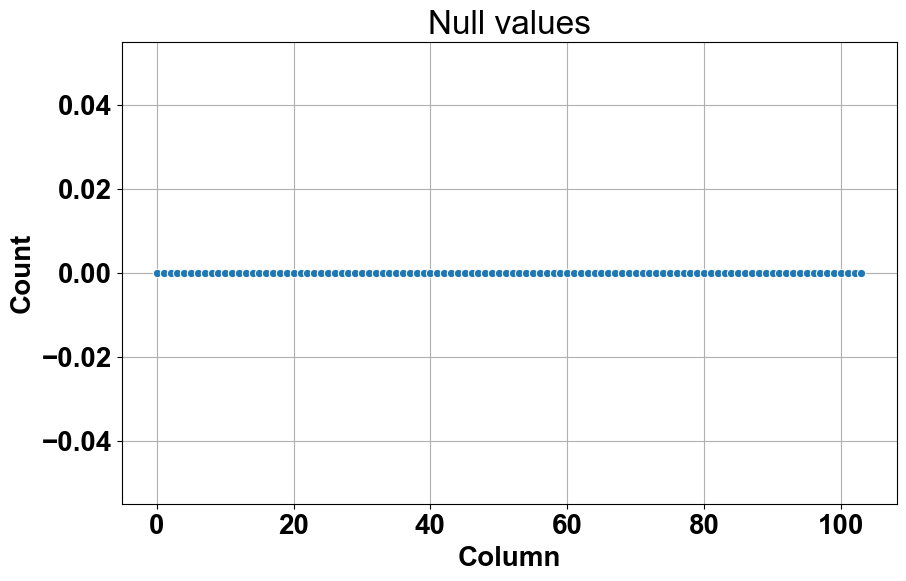

In [24]:

# def describe_df(df):
#     print(df.info(),"\n") 
#     print(df.isnull().sum(),"\n")
#     print(df.head(1))
#     print(df.describe())
#     #  figure and axis for null values
def plot_na(df):
    isn=df.isnull().sum()
    plt.figure(figsize=(10, 6)) 
    ax = sns.lineplot(x=range(len(isn)), y=isn, marker='o', linestyle='-')

    ax.set_xlabel('Column')
    ax.set_ylabel('Count')
    ax.set_title('Null values')

    ax.grid(True)

    plt.show()
plot_na(df)

## Supervised Learning

In [25]:
X = df.drop('Mortality', axis=1)  # Features
y = df['Mortality']  # Target variable
print(X.shape)
print(y.shape)

(63, 103)
(63,)


In [26]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=1)
print("Train length",len(X_train))
print("Test length",len(X_test))
#Train=37
#Test=26
#Traintestsplit function randomly splits the data into train and test, without maintaining any particular order

Train length 37
Test length 26


In [27]:
i=0
for x in X.columns:
    i+=1
    print(i," - ",x)

1  -  Age
2  -  Inj Mech
3  -  Inj Pattern
4  -  Hemmorhage
5  -  TBI yes/no
6  -  SCI yes/no
7  -  Blood Products y/n
8  -  Blood Products Cumulative
9  -  Max Stiffness (Pa)
10  -  T to Half Max (s)
11  -  Clotting Rate (Pa/s)
12  -  tPA (pg/mL)
13  -  D'dimer (ng/mL)
14  -  Delta OD
15  -  Turbidity T to Half Max (s)
16  -  Polym Rate (OD/s)
17  -  Lysis at One Hour (%)
18  -  Confocal Area (%)
19  -  Fiber length (um)
20  -  Confocal Pore Diameter (μm)
21  -  Fibrinogen (mg/mL)
22  -  Lag Time (min)
23  -  Peak Thrombin (nM)
24  -  Time to peak (min)
25  -  Velocity Index
26  -  ETP (nM)
27  -  sex
28  -  race
29  -  ethnicity
30  -  htn
31  -  ckd
32  -  dm
33  -  cad
34  -  copd
35  -  bleed_diath
36  -  etoh
37  -  hgb
38  -  Lactate (mmol/L)
39  -  utox
40  -  utox_type___1
41  -  utox_type___2
42  -  utox_type___3
43  -  utox_type___4
44  -  utox_type___5
45  -  utox_type___6
46  -  utox_type___7
47  -  utox_type___8
48  -  Partial Thromboplastin Time[PTT] (s)
49  -  Prothromb

In [28]:
#Random Forest with hyper parameter
from sklearn.ensemble import RandomForestClassifier  # Example classifier

clf_2 = RandomForestClassifier(
    n_estimators=200,          # Number of trees in the forest
    max_features=20,       # Number of features to consider at each split
    bootstrap=True,            # Whether to use bootstrapped samples
    random_state=1,            # Random seed for reproducibility
    oob_score=True,
    n_jobs=10,
    # verbose=2
)

# Fit the classifier to your training data
clf_2.fit(X_train, y_train)

from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

y_pred_2 = clf_2.predict(X_test)
acc = accuracy_score(y_test, y_pred_2)
print(f'Accuracy: {acc:.2f}')
print(classification_report(y_test, y_pred_2))
cm=(confusion_matrix(y_test, y_pred_2))


Accuracy: 0.88
              precision    recall  f1-score   support

         0.0       0.90      0.95      0.92        19
         1.0       0.83      0.71      0.77         7

    accuracy                           0.88        26
   macro avg       0.87      0.83      0.85        26
weighted avg       0.88      0.88      0.88        26



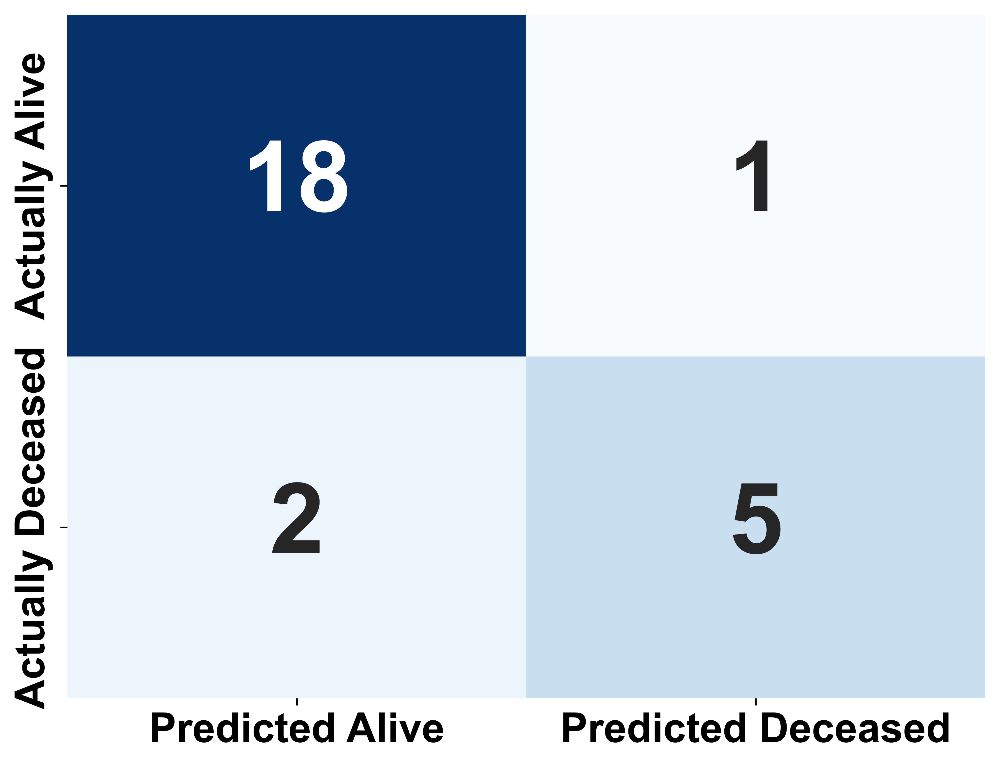

In [29]:
import matplotlib.pyplot as plt
import seaborn as sns
# Set the font family to Helvetica
# plt.rcParams['font.family'] = 'sans-serif'
# plt.rcParams['font.sans-serif'] = 'Helvetica'
# Create a heatmap for the confusion matrix
plt.figure(figsize=(8, 6), dpi=600)
# Increase font size with fontsize parameter
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['Predicted Alive', 'Predicted Deceased'],
            yticklabels=['Actually Alive', 'Actually Deceased'], 
            annot_kws={'size': 48})  # You can adjust the size value as needed

# Set font size for x and y labels
plt.xticks(fontsize=20)  # Adjust the font size as needed
plt.yticks(fontsize=20)  # Adjust the font size as needed

# plt.xlabel('Predicted')
# plt.ylabel('Actual')
# plt.title('Confusion Matrix',fontsize=20)
# plt.savefig("Plots_2/confusion_matrix_2.png", format="png")
plt.show()


In [30]:
# Getting feature importances
feature_importances_main = clf_2.feature_importances_
feature_importances_main*=100
# Matching feature importances with feature names
feature_names_main = X.columns  # Replacing with the actual feature names
feature_importance_dict_main = dict(zip(feature_names_main, feature_importances_main))

# Sorting feature importances by importance score
sorted_feature_importances_main = sorted(feature_importance_dict_main.items(), key=lambda x: x[1]*100, reverse=True)

# Printing the sorted feature importances
s=0
i=0
for feature, importance in sorted_feature_importances_main:
    # print(f"{feature}: \t\t\t{importance*100:.4f}")
    s+=importance
    i+=1
    print(f"{importance:.4f} %\t:\t{feature}")
    print(s)
    if s>90:
        break
    # break
print(i)
# print(s)

14.6665 %	:	D'dimer (ng/mL)
14.666484663414927
8.1431 %	:	Partial Thromboplastin Time[PTT] (s)
22.809583258546745
7.4289 %	:	Clotting Rate (Pa/s)
30.238458316262854
7.0963 %	:	Fibrinogen (mg/mL)
37.334749082749866
4.8586 %	:	Abbreviated Injury Scale Head
42.1933581286757
3.6651 %	:	Prothrombin Time[PT] (s)
45.85843485661817
2.9871 %	:	Systolic BP (mmHg)
48.845516847360926
2.9333 %	:	Max Stiffness (Pa)
51.77879119804239
2.8207 %	:	Diastolic BP (mmHg)
54.59944341452928
2.5183 %	:	Confocal Area (%)
57.11776385877986
2.3848 %	:	Revised Trauma Score
59.50253671161191
2.3621 %	:	Temperature (°C)
61.864627167541286
2.1923 %	:	Confocal Pore Diameter (μm)
64.05695258057948
2.1899 %	:	Turbidity T to Half Max (s)
66.24685055485733
2.1570 %	:	Lactate (mmol/L)
68.40389551457545
1.8813 %	:	Glasgow Coma Score
70.28516984807447
1.7825 %	:	Lysis at One Hour (%)
72.06763531200993
1.7050 %	:	tPA (pg/mL)
73.77259240031637
1.6026 %	:	Injury Severity Score[ISS]
75.37515832383555
1.3483 %	:	Velocity Index
76

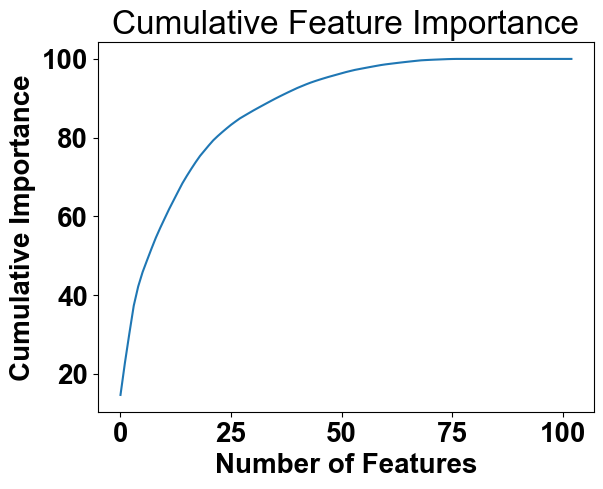

Selected Features: Index([], dtype='object')


In [17]:
# Get feature importances
# feature_importances = clf.feature_importances_

# Sort features by importance
sorted_indices = np.argsort(feature_importances_main)[::-1]
sorted_importances = feature_importances_main[sorted_indices]

# Calculate cumulative importance
cumulative_importance = np.cumsum(sorted_importances)

# Plot cumulative importance
plt.plot(cumulative_importance)
plt.xlabel('Number of Features')
plt.ylabel('Cumulative Importance')
plt.title('Cumulative Feature Importance')
plt.show()

# Select top N features based on a threshold (e.g., 90% cumulative importance)
threshold = 0.90
top_features = X_train.columns[sorted_indices[cumulative_importance <= threshold]]
print(f"Selected Features: {top_features}")

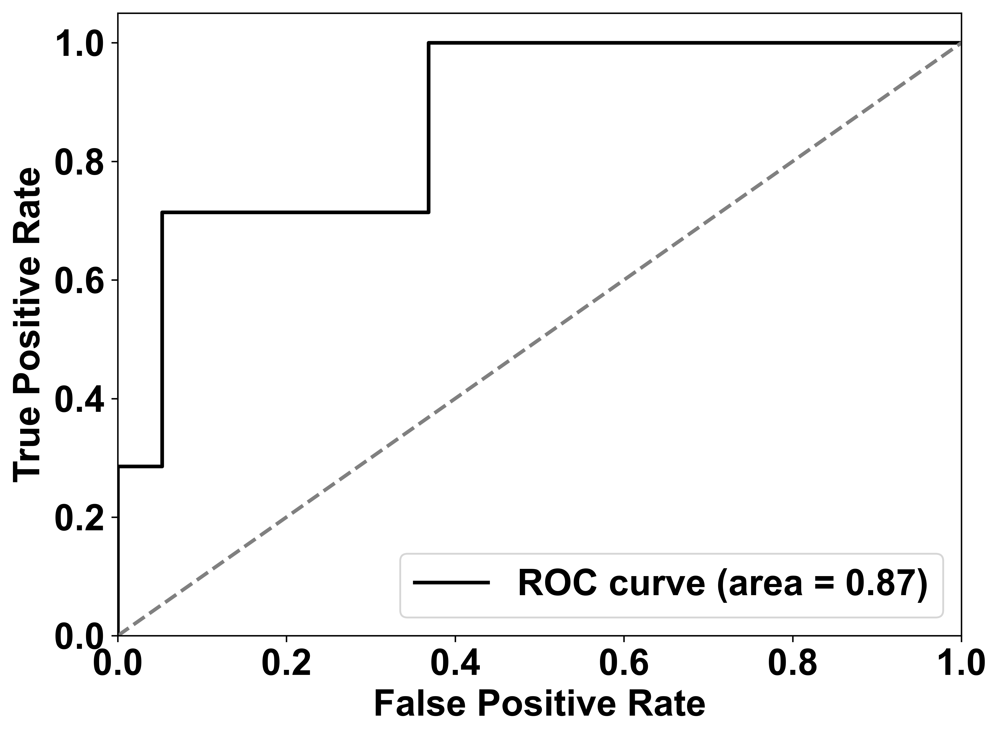

In [11]:
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt
# https://www.youtube.com/watch?v=4jRBRDbJemM
# Compute the probability estimates of the positive class
y_prob = clf_2.predict_proba(X_test)[:, 1]

# Compute the ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_prob)

# Compute the AUC (Area Under the Curve)
roc_auc = roc_auc_score(y_test, y_prob)

# Plot the ROC curve
plt.figure(figsize=(8, 6),dpi=600)
plt.plot(fpr, tpr, color='black', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc))
plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.tight_layout(h_pad=3.0, w_pad=3.0)  # Adjust the padding values as needed
plt.savefig("Plots_2/roc.png", format="png")
plt.show()


Receiver Operating Characteristic (ROC) Curve for in-hospital mortality prediction from our Random Forest model, integrating both clinical and laboratory biomechanical measurements, has an AUC of 0.82. This indicates good discriminatory power in distinguishing between positive and negative cases.

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams["font.size"] = '20'

num_top_features = 20  # Change this to the number of top features you want to visualize

top_feature_names = [feature for feature, _ in sorted_feature_importances_main[:num_top_features]]

num_cols = 4
num_rows = (num_top_features + num_cols - 1) // num_cols

plt.figure(figsize=(16, num_rows * 4),dpi=600)
plt.tight_layout(rect=[0, 0.03, 1, 1.2])
# plt.subplots_adjust(top=0.92)

for i, feature in enumerate(top_feature_names):
    plt.subplot(num_rows, num_cols, i + 1)
    boxplot = sns.boxplot(x=df['Mortality'], y=df[feature], palette=['#1f77b4', '#ff7f0e'])
    plt.ylabel(feature)
    boxplot.set_xticklabels(['Alive', 'Deceased'],fontweight='bold')
    
plt.tight_layout(h_pad=2.0, w_pad=2.0) 

plt.savefig("Plots_2/box_plots.png", format="png")
plt.show()


In [69]:
# Histogram plot - Bar
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Define the number of top features you want to visualize
# num_top_features = 5  # Change this to the number of top features you want to visualize

# # Extract the names of the most important features from the sorted list
# top_feature_names = [feature for feature, _ in sorted_feature_importances_main[:num_top_features]]

# # Create histograms for the top features
# for feature in top_feature_names:
#     plt.figure(figsize=(8, 6))
    
#     # Create a histogram for "Alive" individuals
#     sns.histplot(df[df['Mortality'] == 0][feature], label='Alive', color='skyblue')
    
#     # Create a histogram for "Deceased" individuals
#     sns.histplot(df[df['Mortality'] == 1][feature], label='Deceased', color='salmon')
    
#     plt.title(f'Histogram of {feature} for Alive and Deceased')
#     plt.xlabel(feature)
#     plt.ylabel('Count')
#     plt.legend()
    
#     plt.show()


In [16]:
#Swarm Plots

# Define the number of top features you want to visualize
num_top_features = 20  # Change this to the number of top features you want to visualize

# Extract the names of the most important features from the sorted list
top_feature_names = [feature for feature, _ in sorted_feature_importances_main[:num_top_features]]
num_cols = 4
num_rows = (num_top_features + num_cols - 1) // num_cols
plt.figure(figsize=(16, num_rows * 4),dpi=600)
# plt.legend(title='Mortality', labels=['Alive', 'Deceased'])

# for feature in top_feature_names:
for i, feature in enumerate(top_feature_names):
    plt.subplot(num_rows, num_cols, i + 1)
    
    # Create a swarm plot with "Mortality" (0 and 1) as the hue to distinguish between classes
    # swmplt=sns.swarmplot(x='Mortality', y=feature, data=df, hue='Mortality', palette=['skyblue', 'salmon'], size=6,legend=False)
    swmplt=sns.swarmplot(x='Mortality', y=feature, data=df, hue='Mortality', palette=['#1f77b4', '#ff7f0e'], size=6,legend=False)
    # plt.title(f'Swarm Plot of {feature} for Alive and Deceased')
    plt.xlabel('')
    # Change x-axis tick labels
    swmplt.set_xticklabels(['Alive', 'Deceased'])
    plt.ylabel(feature)
plt.tight_layout(h_pad=2.0, w_pad=2.0)  # Adjust the padding values as needed
# Add padding at the top
# plt.subplots_adjust(top=1.5)
t="Plots_2/swarm_plots.png"
# t="Plots_2/Swarm_Plots/1.png"
# plt.savefig(t,format="png")
plt.show()
# break


In [13]:
# Create a figure for all density plots
num_top_features = 20  # Change this to the number of top features you want to visualize

top_feature_names = [feature for feature, _ in sorted_feature_importances_main[:num_top_features]]

num_rows=5
num_cols=4
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 4), dpi=600)
# plt.subplots_adjust(left=0.5)
plt.tight_layout(rect=[0, 0.03, 1.5, 0.95],h_pad=3.0, w_pad=5.0) 
# plt.tight_layout(h_pad=3.0, w_pad=3.0) 
# Create lists to store handles and labels for the legend
legend_handles = []
legend_labels = []
# ['#1f77b4', '#ff7f0e']
pal=['#149824','#fc4127']#green,red
# pal=['#1f77b4', '#ff7f0e']#Orange, blue
for i, feature in enumerate(top_feature_names):
    ax = axes[i // num_cols, i % num_cols]

    # Create a density plot for "Alive" individuals
    sns.kdeplot(df[df['Mortality'] == 0][feature], label='Alive', color=pal[0], shade=True, ax=ax,alpha=0.7)
    # Create a density plot for "Deceased" individuals
    sns.kdeplot(df[df['Mortality'] == 1][feature], label='Deceased', color=pal[1], shade=True, ax=ax,alpha=0.7)
    ax.set_xlabel(feature,fontsize=24)
    ax.set_ylabel('Density')

    # Store the handles and labels for the legend
    if i == 0:
        handles, labels = ax.get_legend_handles_labels()
        legend_handles.extend(handles)
        legend_labels.extend(labels)

# Add the legend at the top of the combined figure
# fig.legend(legend_handles, legend_labels, loc='lower center')

# Adjust the subplot layout
# plt.tight_layout()

t = "Plots_2/density_plots.png"
# plt.savefig(t)
plt.show()


In [33]:
# Create a figure for all density plots
num_top_features = 20  # Change this to the number of top features you want to visualize

top_feature_names = [feature for feature, _ in sorted_feature_importances_main[:num_top_features]]

num_rows=5
num_cols=4
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 4), dpi=600)
# plt.subplots_adjust(left=0.5)
plt.tight_layout(rect=[0, 0.03, 1.5, 0.95],h_pad=1.5, w_pad=1.0) 
# plt.tight_layout(h_pad=3.0, w_pad=3.0) 
# Create lists to store handles and labels for the legend
legend_handles = []
legend_labels = []
# ['#1f77b4', '#ff7f0e']
# pal=['#1f77b4', '#ff7f0e']
pal=['#149824','#fc4127']#green,red

for i, feature in enumerate(top_feature_names):
    ax = axes[i // num_cols, i % num_cols]

    # Create a density plot for "Alive" individuals
    sns.kdeplot(df[df['Mortality'] == 0][feature], label='Survived', color=pal[0], shade=True, ax=ax,alpha=0.7)
    # Create a density plot for "Deceased" individuals
    sns.kdeplot(df[df['Mortality'] == 1][feature], label='Deceased', color=pal[1], shade=True, ax=ax,alpha=0.7)
    # if "Partial Thromboplastin" in feature:
    #     ax.set_xlabel("Partial Thromboplastin\nTime[PTT](s)",fontsize=24)
    # else:
    ax.set_xlabel(feature,fontsize=24)
    ax.set_ylabel('Density')

    # Store the handles and labels for the legend
    if i == 0:
        handles, labels = ax.get_legend_handles_labels()
        legend_handles.extend(handles)
        legend_labels.extend(labels)

# Add the legend at the top of the combined figure
legend=fig.legend(legend_handles, legend_labels, loc='upper right')

# Make the legend text bold
for text in legend.get_texts():
    text.set_weight('bold')
# Adjust the subplot layout
# plt.tight_layout()

t = "Plots_2/density_plots_3.png"
# plt.savefig(t)
plt.show()


The density plots are mainly shown for those features which were found to be significant in predicting the mortality of patients. The pattern that can be seen across many plots, is that the alive and deceased density functions conform to gaussian distribution; The mean and standard deviation of Alive is distinct in comparison with that of Deceased functions which in turn is a factor in accurate modeling of the data for prediction  

In [13]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the number of top features you want to visualize
num_top_features = 20  # Change this to the number of top features you want to visualize

# Extract the names of the most important features from the sorted list
top_feature_names = [feature for feature, _ in sorted_feature_importances_main[:num_top_features]]

# Calculate the number of rows needed based on the number of top features and fixed columns
num_cols = 4
num_rows = (num_top_features + num_cols - 1) // num_cols

# Create subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 4), dpi=600)
# fig.suptitle('Box Plots of Top Features by Gender and Mortality', fontsize=16)
# plt.tight_layout(rect=[0, 0.03, 1, 1.2],h_pad=2.0, w_pad=2.0) 
# plt.tight_layout(rect=[0.2, 0.03, 1, 1.5],h_pad=2.0, w_pad=2.0) 

# Initialize an empty list for feature labels
labels = []

for i, feature in enumerate(top_feature_names):
    row = i // num_cols
    col = i % num_cols
    ax = axes[row, col]

    # Create a box plot that separates data by gender and mortality
    sns.boxplot(x='sex', y=feature, hue='Mortality', data=df, palette=['#1f77b4', '#ff7f0e'], ax=ax)
    ax.set_xticklabels(['Male', 'Female'])

    ax.set_xlabel('')
    ax.set_ylabel(feature)
    
    # Remove the subplot legend
    ax.get_legend().remove()
    
    # Add this feature's label to the common legend
    labels.append(feature)
    # Store the handles and labels for the legend
    

# Remove empty subplots
for i in range(num_top_features, num_cols * num_rows):
    fig.delaxes(axes.flatten()[i])

# # Create a common legend at the top
# legend=fig.legend(title='Mortality', labels=['Alive', 'Deceased'], loc='upper right')
# legend= fig.legend()
# legend=plt.legend()
    # legend.set_title("Mortality")
# legend.texts[0].set_text("Alive")
# legend.texts[1].set_text("Deceased")
# legend.legendHandles[0].set_color('#1f77b4')  # Custom color for "Alive"
# legend.legendHandles[1].set_color('#ff7f0e')  # Custom color for "Deceased"
# plt.tight_layout()
# plt.tight_layout(h_pad=2.0, w_pad=2.0) 
# plt.tight_layout(rect=[0, 0.03, 1, 1.2],h_pad=2.0, w_pad=2.0) 
plt.tight_layout(rect=[0, 0.03, 1, 1.15],h_pad=1, w_pad=2.0) 

# plt.subplots_adjust(top=0.9)
t="Plots_2/Gender_Box_Plots_2.png"
plt.savefig(t,format="png")
plt.show()


These are box plots of patients based upon their gender and mortality to represent central tendency and variability. 
Outliers can be seen in the top features indicating unusual values of features which in turn help in mortality prediction. 
For any particular feature and gender, similar trend(increase or decrease of inter-quartile ranges) is observed for each mortality class.
Specifically we can see an increase in the Inter-quartile ranges for Ddimer, PTT, AIS_Head, Injury Severity Score. While a decrease in the IQ-ranges for Polymerisation Rate, Fibrinogen, Max Pa

In [85]:
cl=["viridis",
"plasma",
"inferno",
"magma",
"cividis",
"Blues",
"YlGnBu",
"BuGn",
"RdPu",
"autumn",
"winter",
"cool"]

In [93]:
import matplotlib.pyplot as plt
import seaborn as sns

# Extract feature names and importance scores
top_features=sorted_feature_importances_main[:15]
feature_names = [x[0].upper() for x in top_features]
importance_scores = [x[1] for x in top_features]
cl=["viridis"]
for col in cl:
    print(col)
    plt.figure(figsize=(20, 10),dpi=600)
    sns.barplot(x=importance_scores, y=feature_names, orient="h", palette=col)
    # Customize the plot
    plt.xlabel("Feature Importance(%)")
    plt.ylabel("Feature Name")
    plt.title("Top 15 Features for Diagnosing Mortality")
    plt.savefig("Plots_2/Feature_importance_viridis.png",format="png")
    # Show the plot
    plt.show()
    # break

viridis


In [31]:
# Best Hyperparameters:
# {'bootstrap': True, 'max_depth': None, 'max_features': 20, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 200}

In [32]:
from sklearn.svm import SVC
# Initialize the SVM classifier
svm_classifier = SVC(kernel='linear', random_state=42)  # You can choose different kernels like 'rbf', 'poly', etc.

# Train the model on the training data
svm_classifier.fit(X_train, y_train)

# Make predictions on the test data
y_pred = svm_classifier.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')

# Display classification report and confusion matrix
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.69
              precision    recall  f1-score   support

         0.0       0.88      0.70      0.78        20
         1.0       0.40      0.67      0.50         6

    accuracy                           0.69        26
   macro avg       0.64      0.68      0.64        26
weighted avg       0.77      0.69      0.71        26

[[14  6]
 [ 2  4]]


In [69]:
X.shape

(63, 103)

In [75]:
import tensorflow
import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
# from sklearn.model_selection import train_test_split

# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=1)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=1)

# Define a simple neural network model
# model = Sequential()
# model.add(Dense(64, input_dim=X_train.shape[1], activation='relu'))
# model.add(Dropout(0.5))
# model.add(Dense(32, activation='relu'))
# model.add(Dropout(0.5))
# model.add(Dense(1, activation='sigmoid'))

model = Sequential()
model.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
# model.add(BatchNormalization())  # Add BatchNormalization
model.add(Dropout(0.5))
model.add(Dense(64, activation='relu'))
# model.add(BatchNormalization())  # Add BatchNormalization
model.add(Dropout(0.5))
model.add(Dense(32, activation='relu'))
# model.add(BatchNormalization())  # Add BatchNormalization
model.add(Dropout(0.5))
model.add(Dense(8, activation='relu'))
# model.add(BatchNormalization())  # Add BatchNormalization
model.add(Dropout(0.5))
model.add(Dense(1, activation='sigmoid'))

 
# Compile the model
model.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.005), metrics=['accuracy'])

# Set up early stopping to prevent overfitting
# early_stopping= EarlyStopping(monitor='val_loss', patience=15, verbose=1, restore_best_weights=True)

# Train the model
epochs=1000
batch_size=16
#1000,16=84.62 , no early stopping

# history = model.fit(X_train, y_train, epochs=100, batch_size=16, validation_data=(X_val, y_val), callbacks=[early_stopping])
history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_data=(X_val, y_val))

# Evaluate the model on the test set
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print(f'Test Loss: {test_loss:.4f}')
print(f'Test Accuracy: {test_accuracy:.4f}')

Epoch 1/1000
3/3 [==============================] - 1s 90ms/step - loss: 0.9824 - accuracy: 0.4054 - val_loss: 0.6580 - val_accuracy: 0.6923
Epoch 2/1000
3/3 [==============================] - 0s 14ms/step - loss: 1.0658 - accuracy: 0.4595 - val_loss: 0.6482 - val_accuracy: 0.8462
Epoch 3/1000
3/3 [==============================] - 0s 14ms/step - loss: 0.9436 - accuracy: 0.5676 - val_loss: 0.7788 - val_accuracy: 0.7692
Epoch 4/1000
3/3 [==============================] - 0s 13ms/step - loss: 0.9020 - accuracy: 0.6757 - val_loss: 0.9051 - val_accuracy: 0.6923
Epoch 5/1000
3/3 [==============================] - 0s 14ms/step - loss: 0.8758 - accuracy: 0.5405 - val_loss: 0.9601 - val_accuracy: 0.6923
Epoch 6/1000
3/3 [==============================] - 0s 13ms/step - loss: 0.6870 - accuracy: 0.5405 - val_loss: 0.9347 - val_accuracy: 0.6923
Epoch 7/1000
3/3 [==============================] - 0s 13ms/step - loss: 0.8959 - accuracy: 0.4054 - val_loss: 0.9014 - val_accuracy: 0.6923
Epoch 8/1000


In [76]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_10 (Dense)            (None, 128)               13312     
                                                                 
 batch_normalization (BatchN  (None, 128)              512       
 ormalization)                                                   
                                                                 
 dropout_8 (Dropout)         (None, 128)               0         
                                                                 
 dense_11 (Dense)            (None, 64)                8256      
                                                                 
 batch_normalization_1 (Batc  (None, 64)               256       
 hNormalization)                                                 
                                                                 
 dropout_9 (Dropout)         (None, 64)               

In [77]:
import visualkeras
visualkeras.layered_view(model)

In [68]:
from ann_visualizer.visualize import ann_viz
ann_viz(model, title="Neural Network Architecture",view=True,filename="nn")